##**Climatesocpe Project-Milestone 1**
## **Exploratory DataAnalysis(EDA)+Aggregation**

In [19]:
from google.colab import files
uploaded=files.upload()
print(uploaded)

Saving GlobalWeatherRepository.csv to GlobalWeatherRepository.csv
{'GlobalWeatherRepository.csv': b"country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,wind_mph,wind_kph,wind_degree,wind_direction,pressure_mb,pressure_in,precip_mm,precip_in,humidity,cloud,feels_like_celsius,feels_like_fahrenheit,visibility_km,visibility_miles,uv_index,gust_mph,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination\nAfghanistan,Kabul,34.52,69.18,Asia/Kabul,1715849100,2024-05-16 13:15,26.6,79.8,Partly Cloudy,8.3,13.3,338,NNW,1012.0,29.89,0.0,0.0,24,30,25.3,77.5,10.0,6.0,7.0,9.5,15.3,277.0,103.0,1.1,0.2,8.4,26.6,1,1,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55\nAlbania,Tirana,41.33,19.82,Europe/Tirane,1715849

In [ ]:
#importing Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
#1.Display settings
pd.set_option("display.max_columns", None)
sns.set_theme(style="ticks", palette="muted")

In [ ]:
#2.Loading the Dataset
df = pd.read_csv("GlobalWeatherRepository.csv") # <-- replace with actual filename
print("Dataset Shape:", df.shape)

Dataset Shape: (90612, 41)


In [ ]:
#3.Datatype Inspection
print("\n--- Data Types ---")
print(df.dtypes)
num_cols = df.select_dtypes(include=np.number).columns.tolist()
cat_cols = df.select_dtypes(include="object").columns.tolist()
date_cols = df.select_dtypes(include="datetime").columns.tolist()
print("\n--- Columns by Type ---")
print("Numeric Columns:", num_cols)
print("Categorical Columns:", cat_cols)
print("Datetime Columns:", date_cols)


--- Data Types ---
country                          object
location_name                    object
latitude                        float64
longitude                       float64
timezone                         object
last_updated_epoch                int64
last_updated                     object
temperature_celsius             float64
temperature_fahrenheit          float64
condition_text                   object
wind_mph                        float64
wind_kph                        float64
wind_degree                       int64
wind_direction                   object
pressure_mb                     float64
pressure_in                     float64
precip_mm                       float64
precip_in                       float64
humidity                          int64
cloud                             int64
feels_like_celsius              float64
feels_like_fahrenheit           float64
visibility_km                   float64
visibility_miles                float64
uv_index            

In [78]:
#Check missing values
print("\nMissing values (%):\n", (df.isna().mean() * 100).sort_values(ascending=False).head(10))


Missing values (%):
 country                   0.0
location_name             0.0
latitude                  0.0
longitude                 0.0
timezone                  0.0
last_updated_epoch        0.0
last_updated              0.0
temperature_celsius       0.0
temperature_fahrenheit    0.0
condition_text            0.0
dtype: float64


In [79]:
#Basic cleaning
## Rename columns to lowercase_with_underscores
df.columns = (
    df.columns.str.strip()
              .str.lower()
              .str.replace(" ", "_")
              .str.replace(r"[^a-z0-9_]", "", regex=True)
)

## Parse datetime
if "last_updated" in df.columns:
    df["last_updated"] = pd.to_datetime(df["last_updated"], errors="coerce")
    df["year"] = df["last_updated"].dt.year
    df["month"] = df["last_updated"].dt.month

## Remove duplicates
df = df.drop_duplicates()

## Handle missing humidity & precipitation
if "humidity" in df.columns:
    df["humidity"] = df["humidity"].clip(0, 100)

if "precip_mm" in df.columns:
    df["precip_mm"] = df["precip_mm"].clip(lower=0)

# Wind speed: derive meters/second from km/h
if "wind_kph" in df.columns:
    df["wind_speed_ms"] = df["wind_kph"] / 3.6

# Pressure: rename mb -> hPa
if "pressure_mb" in df.columns:
    df = df.rename(columns={"pressure_mb":"pressure_hpa"})
print("Shape after cleaning:", df.shape)
print("Missing values (%):\n", (df.isna().mean() * 100).head(10))
print("\nSample cleaned data:\n", df.head(5))

Shape after cleaning: (90612, 45)
Missing values (%):
 country                   0.0
location_name             0.0
latitude                  0.0
longitude                 0.0
timezone                  0.0
last_updated_epoch        0.0
last_updated              0.0
temperature_celsius       0.0
temperature_fahrenheit    0.0
condition_text            0.0
dtype: float64

Sample cleaned data:
        country     location_name  latitude  longitude        timezone  last_updated_epoch        last_updated  temperature_celsius  temperature_fahrenheit  \
0  Afghanistan             Kabul     34.52      69.18      Asia/Kabul          1715849100 2024-05-16 13:15:00                 26.6                    79.8   
1      Albania            Tirana     41.33      19.82   Europe/Tirane          1715849100 2024-05-16 10:45:00                 19.0                    66.2   
2      Algeria           Algiers     36.76       3.05  Africa/Algiers          1715849100 2024-05-16 09:45:00                 23.0   

In [ ]:
# Convert last_updated to datetime (if exists)
if "last_updated" in df.columns:
  df["last_updated"] = pd.to_datetime(df["last_updated"], errors="coerce")
  df["year"] = df["last_updated"].dt.year
  df["month"] = df["last_updated"].dt.month
  df["date"] = df["last_updated"].dt.date

In [ ]:
df[['last_updated']].head()

,last_updated
0,2024-05-16 13:15:00
1,2024-05-16 10:45:00
2,2024-05-16 09:45:00
3,2024-05-16 10:45:00
4,2024-05-16 09:45:00


In [ ]:
from datetime import datetime

today = datetime.today().date()
today_records = df[df['last_updated'].dt.date == today]

if not today_records.empty:
    latest_temp = today_records.sort_values('last_updated', ascending=False).iloc[0]
    print(f"Latest temperature today ({today}): {latest_temp['temperature_celsius']}°C")
    print(f"Recorded at: {latest_temp['last_updated']}")
else:
    print(f"No temperature records found for today ({today}).")


No temperature records found for today (2025-08-27).


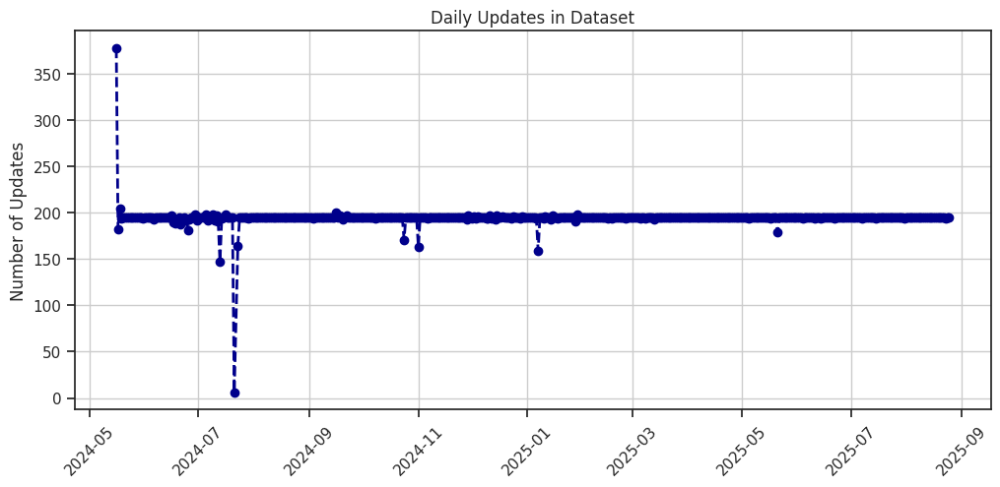

In [ ]:
updates_per_day = df['last_updated'].dt.date.value_counts().sort_index()

plt.figure(figsize=(12, 5))
plt.plot(updates_per_day.index, updates_per_day,
         marker='o', linestyle='--', linewidth=2, color='darkblue')
plt.ylabel('Number of Updates')
plt.title('Daily Updates in Dataset')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


In [39]:
# Aggregate monthly averages
if "location_name" in df.columns and "last_updated" in df.columns:
    # Ensure last_updated is datetime and extract year and month
    df["last_updated"] = pd.to_datetime(df["last_updated"], errors="coerce")
    df["year"] = df["last_updated"].dt.year
    df["month"] = df["last_updated"].dt.month

    # Define columns to aggregate and their aggregation functions
    agg_funcs = {
        "temperature_celsius": "mean",
        "humidity": "mean",
        "precip_mm": "sum",
    }

    # Add wind_kph if available
    if "wind_kph" in df.columns:
        agg_funcs["wind_kph"] = "mean"
    elif "wind_mph" in df.columns:
         agg_funcs["wind_mph"] = "mean"

    # Add pressure_mb if available
    if "pressure_mb" in df.columns:
        agg_funcs["pressure_mb"] = "mean"
    elif "pressure_in" in df.columns:
         agg_funcs["pressure_in"] = "mean"


    # Check if required columns for grouping exist
    grouping_cols = ["country","location_name","year","month"]
    if all(col in df.columns for col in grouping_cols):
        monthly = (
            df.groupby(grouping_cols, as_index=False)
              .agg(agg_funcs)
        )
        monthly.to_csv("monthly_weather.csv", index=False)
        print(" Monthly aggregated dataset saved as monthly_weather.csv")
    else:
        print(" Required columns for monthly aggregation not found.")
else:
    print(" Required columns ('location_name', 'last_updated') for monthly aggregation not found.")

 Monthly aggregated dataset saved as monthly_weather.csv



--- Missing Values ---
Series([], dtype: int64)


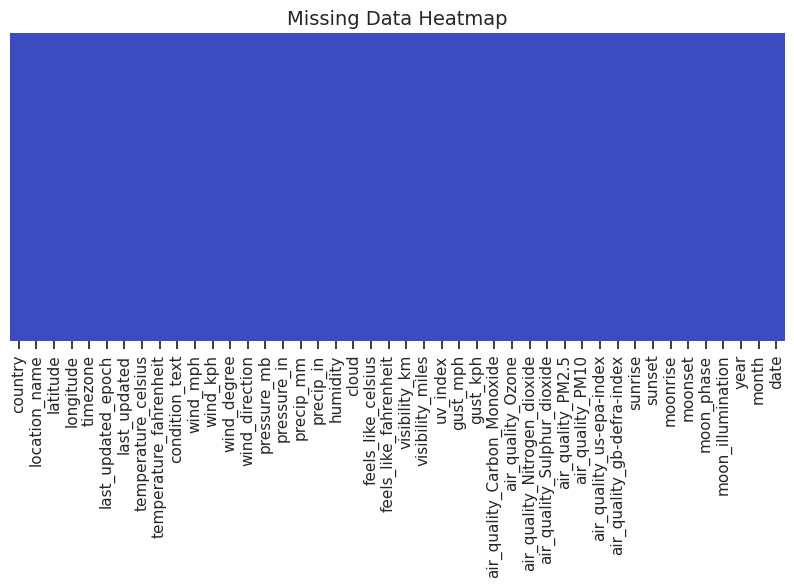

In [ ]:
#  Missing Values

missing = df.isna().sum().sort_values(ascending=False)
print("\n--- Missing Values ---")
print(missing[missing > 0])
plt.figure(figsize=(10,4))
sns.heatmap(df.isna(), yticklabels=False, cbar=False, cmap="coolwarm")
plt.title("Missing Data Heatmap", fontsize=14)
plt.show()

In [ ]:
#  Descriptive Statistics
print("\n--- Summary Statistics ---")
print(df.describe(include="all").T)



--- Summary Statistics ---
                                count unique             top   freq  \
country                         90612    211        Bulgaria    969   
location_name                   90612    254           Kabul    466   
latitude                      90612.0    NaN             NaN    NaN   
longitude                     90612.0    NaN             NaN    NaN   
timezone                        90612    197    Asia/Bangkok   1806   
last_updated_epoch            90612.0    NaN             NaN    NaN   
last_updated                    90612    NaN             NaN    NaN   
temperature_celsius           90612.0    NaN             NaN    NaN   
temperature_fahrenheit        90612.0    NaN             NaN    NaN   
condition_text                  90612     47   Partly cloudy  28670   
wind_mph                      90612.0    NaN             NaN    NaN   
wind_kph                      90612.0    NaN             NaN    NaN   
wind_degree                   90612.0    NaN     

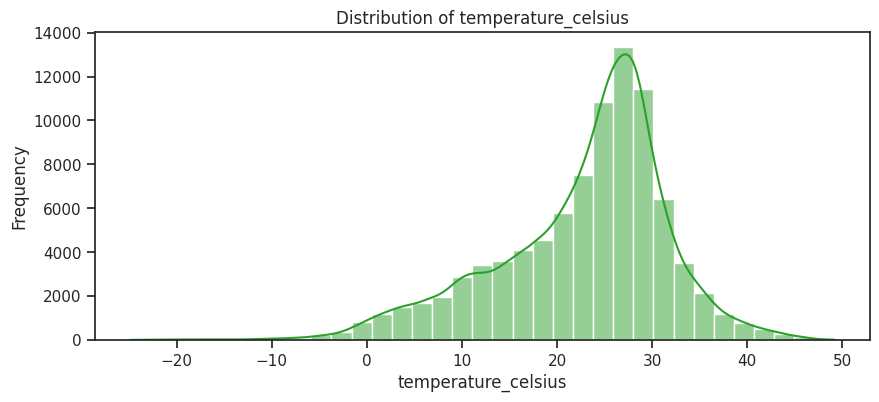

In [ ]:
# Distribution of temperature
import matplotlib.pyplot as plt
import seaborn as sns
#Distribution of Temperature
plt.figure(figsize=(10,4))
sns.histplot(df["temperature_celsius"], bins=35, kde=True, color="#2ca02c")
plt.title("Distribution of temperature_celsius")
plt.xlabel("temperature_celsius")
plt.ylabel("Frequency")
plt.show()


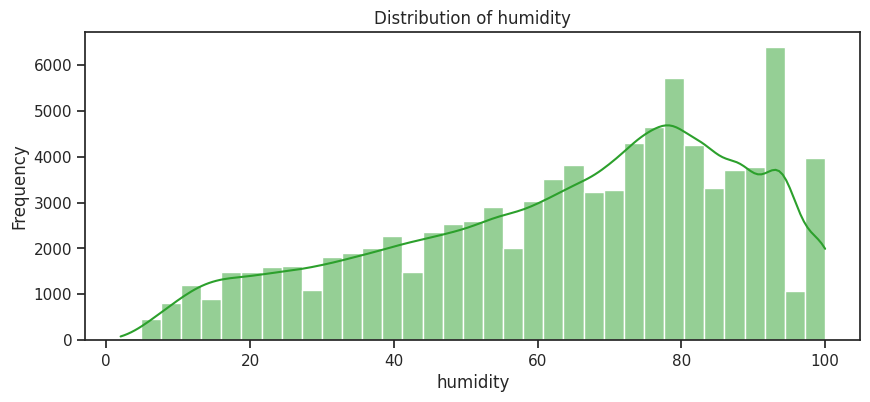

In [ ]:
#Distribution of Humidity
plt.figure(figsize=(10,4))
sns.histplot(df["humidity"], bins=35, kde=True, color="#2ca02c")
plt.title("Distribution of humidity")
plt.xlabel("humidity")
plt.ylabel("Frequency")
plt.show()


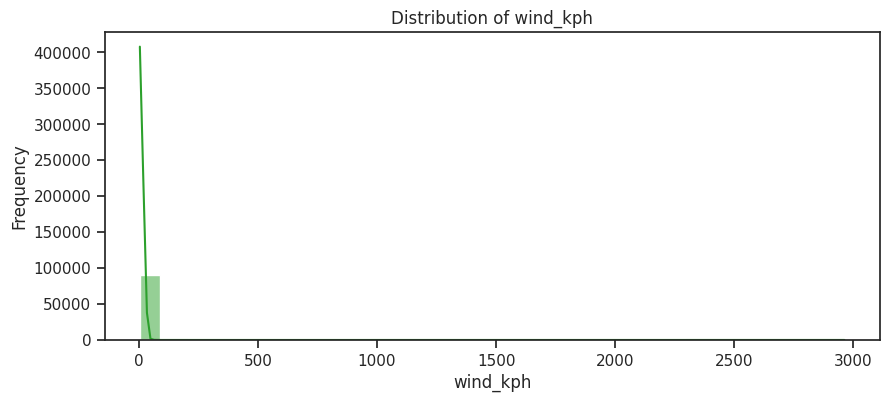

In [ ]:
#Distribution of Wind
plt.figure(figsize=(10,4))
sns.histplot(df["wind_kph"], bins=35, kde=True, color="#2ca02c")
plt.title("Distribution of wind_kph")
plt.xlabel("wind_kph")
plt.ylabel("Frequency")
plt.show()


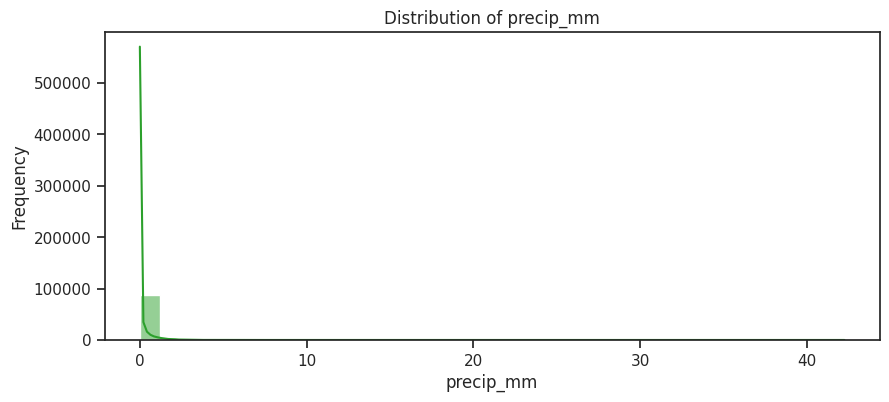

In [ ]:
#Distribution of precipitation
plt.figure(figsize=(10,4))
sns.histplot(df["precip_mm"], bins=35, kde=True, color="#2ca02c")
plt.title("Distribution of precip_mm")
plt.xlabel("precip_mm")
plt.ylabel("Frequency")
plt.show()


In [28]:
# Hexbin Temperature vs Humidity

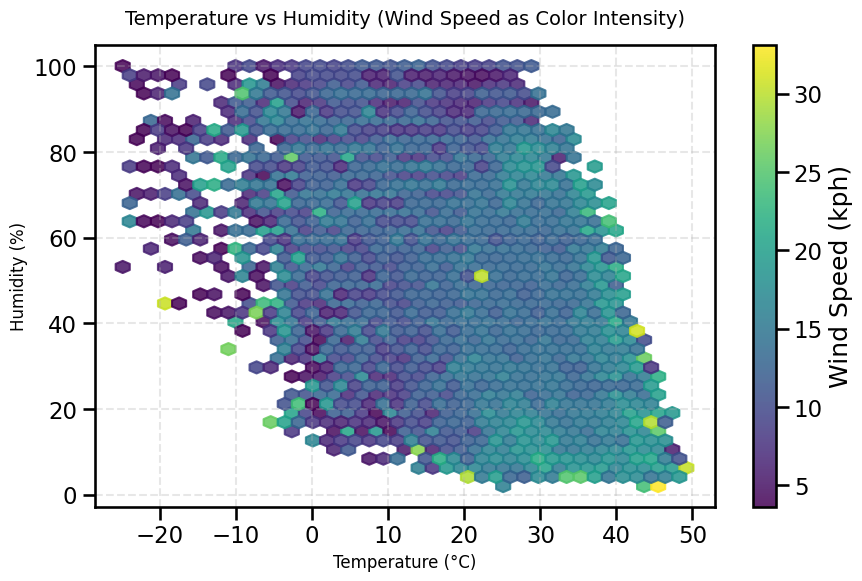

In [31]:
import matplotlib.pyplot as plt
import numpy as np

plt.figure(figsize=(10,6))

hb = plt.hexbin(
    df["temperature_celsius"],
    df["humidity"],
    C=df["wind_kph"],
    gridsize=40,
    cmap="viridis",   # Try "plasma", "inferno", "magma", "cividis", "Spectral"
    reduce_C_function=np.mean,
    alpha=0.85
)

plt.colorbar(hb, label="Wind Speed (kph)")
plt.title("Temperature vs Humidity (Wind Speed as Color Intensity)", fontsize=14, pad=15)
plt.xlabel("Temperature (°C)", fontsize=12)
plt.ylabel("Humidity (%)", fontsize=12)
plt.grid(alpha=0.3, linestyle="--")
plt.show()


In [32]:
#Time-Series Line Plot (Temperature over Time)

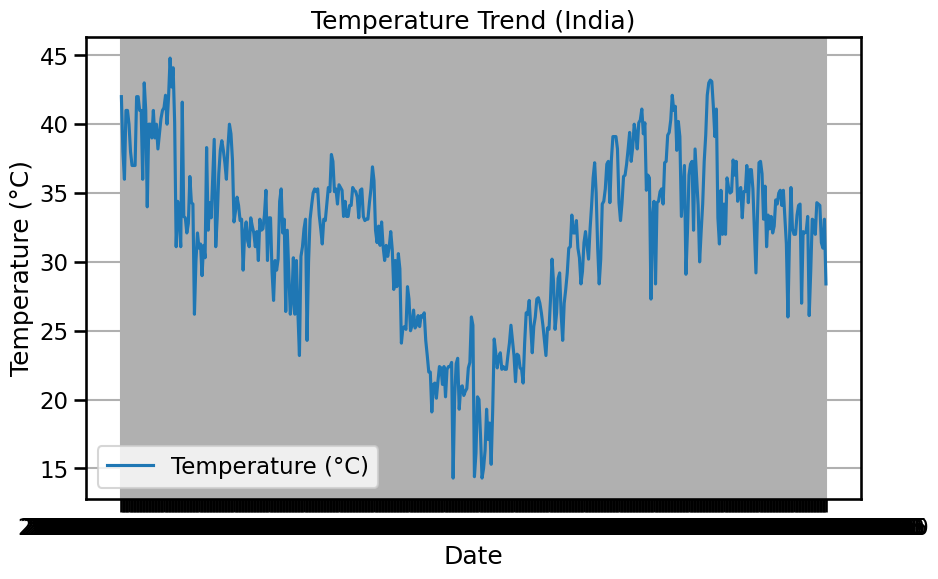

In [34]:
# Pick one country for clarity
country_df = df[df["country"]=="India"].sort_values("last_updated").head(500)

plt.figure(figsize=(10,6))
plt.plot(country_df["last_updated"], country_df["temperature_celsius"], label="Temperature (°C)")
plt.title("Temperature Trend (India)")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.legend()
plt.show()

## Milestone 1 Complted

## Milestone-2 Core Analysis & Visualization Design

 ### Objective: Perform statistical analysis, detect trends, identify extreme events, compare regions, explore correlations, and design visualizations for dashboard wireframes.

In [40]:
import os, sys, math, json, warnings, textwrap
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.ticker import MaxNLocator

import seaborn as sns

from statsmodels.tsa.seasonal import seasonal_decompose
from pandas.plotting import lag_plot, autocorrelation_plot

# Optional libs (used if available)
try:
    import geopandas as gpd
except Exception:
    gpd = None

try:
    import calmap
except Exception:
    calmap = None

# Notebook display settings
pd.set_option("display.max_columns", 100)
pd.set_option("display.width", 160)
sns.set_context("talk")

In [41]:
#2) Load Data

In [43]:
DATA_PATH = "GlobalWeatherRepository.csv"  # <- replace if your file lives elsewhere

df_raw = pd.read_csv(DATA_PATH)
print("Rows:", len(df_raw), "| Columns:", len(df_raw.columns))
df_raw.head(5)


Rows: 90612 | Columns: 41


,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,wind_mph,wind_kph,wind_degree,wind_direction,pressure_mb,pressure_in,precip_mm,precip_in,humidity,cloud,feels_like_celsius,feels_like_fahrenheit,visibility_km,visibility_miles,uv_index,gust_mph,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,1715849100,2024-05-16 13:15,26.6,79.8,Partly Cloudy,8.3,13.3,338,NNW,1012.0,29.89,0.0,0.00,24,30,25.3,77.5,10.0,6.0,7.0,9.5,15.3,277.0,103.0,1.1,0.2,8.4,26.6,1,1,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55
1,Albania,Tirana,41.33,19.82,Europe/Tirane,1715849100,2024-05-16 10:45,19.0,66.2,Partly cloudy,6.9,11.2,320,NW,1012.0,29.88,0.1,0.00,94,75,19.0,66.2,10.0,6.0,5.0,11.4,18.4,193.6,97.3,0.9,0.1,1.1,2.0,1,1,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55
2,Algeria,Algiers,36.76,3.05,Africa/Algiers,1715849100,2024-05-16 09:45,23.0,73.4,Sunny,9.4,15.1,280,W,1011.0,29.85,0.0,0.00,29,0,24.6,76.4,10.0,6.0,5.0,13.9,22.3,540.7,12.2,65.1,13.4,10.4,18.4,1,1,05:40 AM,07:50 PM,01:15 PM,02:14 AM,Waxing Gibbous,55
3,Andorra,Andorra La Vella,42.50,1.52,Europe/Andorra,1715849100,2024-05-16 10:45,6.3,43.3,Light drizzle,7.4,11.9,215,SW,1007.0,29.75,0.3,0.01,61,100,3.8,38.9,2.0,1.0,2.0,8.5,13.7,170.2,64.4,1.6,0.2,0.7,0.9,1,1,06:31 AM,09:11 PM,02:12 PM,03:31 AM,Waxing Gibbous,55
4,Angola,Luanda,-8.84,13.23,Africa/Luanda,1715849100,2024-05-16 09:45,26.0,78.8,Partly cloudy,8.1,13.0,150,SSE,1011.0,29.85,0.0,0.00,89,50,28.7,83.6,10.0,6.0,8.0,12.5,20.2,2964.0,19.0,72.7,31.5,183.4,262.3,5,10,06:12 AM,05:55 PM,01:17 PM,12:38 AM,Waxing Gibbous,55


In [44]:
#3) Normalize columns & Parse Types

In [45]:
def normalize_columns(df: pd.DataFrame) -> pd.DataFrame:
    # lower + strip + replace spaces/symbols
    df = df.copy()
    mapping = {c: (str(c).strip().lower()
                   .replace(" ", "_")
                   .replace("-", "_")
                   .replace(".", "_")) for c in df.columns}
    df = df.rename(columns=mapping)
    return df

def pick_first(df, candidates):
    for c in candidates:
        if c in df.columns:
            return c
    return None

df = normalize_columns(df_raw)

date_col = pick_first(df, ["date","datetime","time","timestamp","day"])
temp_col = pick_first(df, ["temperature","temp","tavg","tmean","avg_temp","mean_temp"])
precip_col = pick_first(df, ["precipitation","precip","rain","prcp","rainfall"])
wind_col = pick_first(df, ["windspeed","wind_speed","wind","windspd","wind_speed_avg"])
humid_col = pick_first(df, ["humidity","rh","rel_humidity"])
pressure_col = pick_first(df, ["pressure","press","mslp","sea_level_pressure"])
cloud_col = pick_first(df, ["cloud","cloud_cover","cloudcover"])

lat_col = pick_first(df, ["latitude","lat"])
lon_col = pick_first(df, ["longitude","lon","lng"])

country_col = pick_first(df, ["country","nation","country_name"])
region_col  = pick_first(df, ["region","state","province","admin","area"])
city_col    = pick_first(df, ["city","location","station","town","place"])

geo_level = None
if country_col: geo_level = "country"
elif region_col: geo_level = "region"
elif city_col: geo_level = "city"

print("Detected columns:")
print(dict(date=date_col, temp=temp_col, precip=precip_col, wind=wind_col, humidity=humid_col,
          pressure=pressure_col, cloud=cloud_col, lat=lat_col, lon=lon_col,
          country=country_col, region=region_col, city=city_col, geo_level=geo_level))

# Parse dates if present
if date_col:
    df[date_col] = pd.to_datetime(df[date_col], errors="coerce")
    # Drop obviously bad date rows
    df = df[~df[date_col].isna()].copy()
    df["year"] = df[date_col].dt.year
    df["month"] = df[date_col].dt.month
    df["day"] = df[date_col].dt.day
    df["doy"] = df[date_col].dt.dayofyear
    df["week"] = df[date_col].dt.isocalendar().week.astype(int)
else:
    print(" No date-like column found; some time-based analysis will be skipped.")

# Add a unified geokey for grouping
def compose_geokey(row):
    if country_col: return str(row.get(country_col, ""))
    if region_col and country_col: return f"{row.get(country_col,'')}-{row.get(region_col,'')}"
    if region_col: return str(row.get(region_col,""))
    if city_col: return str(row.get(city_col,""))
    return "Unknown"

df["geo_key"] = df.apply(compose_geokey, axis=1)

print("Cleaned shape:", df.shape)
df.head(5)


Detected columns:
{'date': None, 'temp': None, 'precip': None, 'wind': None, 'humidity': 'humidity', 'pressure': None, 'cloud': 'cloud', 'lat': 'latitude', 'lon': 'longitude', 'country': 'country', 'region': None, 'city': None, 'geo_level': 'country'}
 No date-like column found; some time-based analysis will be skipped.
Cleaned shape: (90612, 42)


,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,wind_mph,wind_kph,wind_degree,wind_direction,pressure_mb,pressure_in,precip_mm,precip_in,humidity,cloud,feels_like_celsius,feels_like_fahrenheit,visibility_km,visibility_miles,uv_index,gust_mph,gust_kph,air_quality_carbon_monoxide,air_quality_ozone,air_quality_nitrogen_dioxide,air_quality_sulphur_dioxide,air_quality_pm2_5,air_quality_pm10,air_quality_us_epa_index,air_quality_gb_defra_index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,geo_key
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,1715849100,2024-05-16 13:15,26.6,79.8,Partly Cloudy,8.3,13.3,338,NNW,1012.0,29.89,0.0,0.00,24,30,25.3,77.5,10.0,6.0,7.0,9.5,15.3,277.0,103.0,1.1,0.2,8.4,26.6,1,1,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55,Afghanistan
1,Albania,Tirana,41.33,19.82,Europe/Tirane,1715849100,2024-05-16 10:45,19.0,66.2,Partly cloudy,6.9,11.2,320,NW,1012.0,29.88,0.1,0.00,94,75,19.0,66.2,10.0,6.0,5.0,11.4,18.4,193.6,97.3,0.9,0.1,1.1,2.0,1,1,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55,Albania
2,Algeria,Algiers,36.76,3.05,Africa/Algiers,1715849100,2024-05-16 09:45,23.0,73.4,Sunny,9.4,15.1,280,W,1011.0,29.85,0.0,0.00,29,0,24.6,76.4,10.0,6.0,5.0,13.9,22.3,540.7,12.2,65.1,13.4,10.4,18.4,1,1,05:40 AM,07:50 PM,01:15 PM,02:14 AM,Waxing Gibbous,55,Algeria
3,Andorra,Andorra La Vella,42.50,1.52,Europe/Andorra,1715849100,2024-05-16 10:45,6.3,43.3,Light drizzle,7.4,11.9,215,SW,1007.0,29.75,0.3,0.01,61,100,3.8,38.9,2.0,1.0,2.0,8.5,13.7,170.2,64.4,1.6,0.2,0.7,0.9,1,1,06:31 AM,09:11 PM,02:12 PM,03:31 AM,Waxing Gibbous,55,Andorra
4,Angola,Luanda,-8.84,13.23,Africa/Luanda,1715849100,2024-05-16 09:45,26.0,78.8,Partly cloudy,8.1,13.0,150,SSE,1011.0,29.85,0.0,0.00,89,50,28.7,83.6,10.0,6.0,8.0,12.5,20.2,2964.0,19.0,72.7,31.5,183.4,262.3,5,10,06:12 AM,05:55 PM,01:17 PM,12:38 AM,Waxing Gibbous,55,Angola


In [47]:
#4) Data Health and Summary

In [48]:
display(df.describe(include='all').transpose().head(30))
display(df.isna().mean().sort_values(ascending=False).head(20).to_frame("na_fraction"))



,count,unique,top,freq,mean,std,min,25%,50%,75%,max
country,90612,211,Bulgaria,969,NaN,NaN,NaN,NaN,NaN,NaN,NaN
location_name,90612,254,Kabul,466,NaN,NaN,NaN,NaN,NaN,NaN,NaN
latitude,90612.0,NaN,NaN,NaN,19.128325,24.468872,-41.3,3.75,17.25,40.4,64.15
longitude,90612.0,NaN,NaN,NaN,22.164081,65.835572,-175.2,-6.8361,23.3167,50.58,179.22
timezone,90612,197,Asia/Bangkok,1806,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last_updated_epoch,90612.0,NaN,NaN,NaN,1736026529.668256,11652169.367996,1715849100.0,1725971400.0,1736072100.0,1746089100.0,1756108800.0
last_updated,90612,15316,2025-01-23 11:30,44,NaN,NaN,NaN,NaN,NaN,NaN,NaN
temperature_celsius,90612.0,NaN,NaN,NaN,22.729262,9.042039,-24.9,18.0,25.0,28.4,49.2
temperature_fahrenheit,90612.0,NaN,NaN,NaN,72.914406,16.275452,-12.8,64.4,77.0,83.1,120.6
condition_text,90612,47,Partly cloudy,28670,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,na_fraction
country,0.0
location_name,0.0
latitude,0.0
longitude,0.0
timezone,0.0
last_updated_epoch,0.0
last_updated,0.0
temperature_celsius,0.0
temperature_fahrenheit,0.0
condition_text,0.0


In [49]:
# 5) Feature Engineering

In [50]:
# Temperature anomaly: deviation from long-term (by month & geo)
if date_col and temp_col:
    monthly_baseline = (df.groupby(["geo_key","month"])[temp_col]
                          .mean().rename("temp_month_avg"))
    df = df.join(monthly_baseline, on=["geo_key","month"])
    df["temp_anomaly"] = df[temp_col] - df["temp_month_avg"]

# Simple wet day flag
if precip_col:
    df["wet_day"] = (df[precip_col] > 0).astype(int)

# Heat index approximation (simple Steadman's formula, basic)
if temp_col and humid_col:
    # Convert to Fahrenheit for a common formula then back to C if temp appears Celsius
    T = df[temp_col].astype(float)
    RH = df[humid_col].astype(float).clip(0,100)
    # assume C if typical range -50..60
    is_celsius = (T.between(-60, 70)).mean() > 0.8
    Tf = T*9/5+32 if is_celsius else T
    HI_f = -42.379 + 2.04901523*Tf + 10.14333127*RH - 0.22475541*Tf*RH \
           - 6.83783e-3*Tf**2 - 5.481717e-2*RH**2 + 1.22874e-3*Tf**2*RH \
           + 8.5282e-4*Tf*RH**2 - 1.99e-6*Tf**2*RH**2
    df["heat_index"] = (HI_f - 32)*5/9 if is_celsius else HI_f

df.head(3)

,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,wind_mph,wind_kph,wind_degree,wind_direction,pressure_mb,pressure_in,precip_mm,precip_in,humidity,cloud,feels_like_celsius,feels_like_fahrenheit,visibility_km,visibility_miles,uv_index,gust_mph,gust_kph,air_quality_carbon_monoxide,air_quality_ozone,air_quality_nitrogen_dioxide,air_quality_sulphur_dioxide,air_quality_pm2_5,air_quality_pm10,air_quality_us_epa_index,air_quality_gb_defra_index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,geo_key
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,1715849100,2024-05-16 13:15,26.6,79.8,Partly Cloudy,8.3,13.3,338,NNW,1012.0,29.89,0.0,0.0,24,30,25.3,77.5,10.0,6.0,7.0,9.5,15.3,277.0,103.0,1.1,0.2,8.4,26.6,1,1,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55,Afghanistan
1,Albania,Tirana,41.33,19.82,Europe/Tirane,1715849100,2024-05-16 10:45,19.0,66.2,Partly cloudy,6.9,11.2,320,NW,1012.0,29.88,0.1,0.0,94,75,19.0,66.2,10.0,6.0,5.0,11.4,18.4,193.6,97.3,0.9,0.1,1.1,2.0,1,1,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55,Albania
2,Algeria,Algiers,36.76,3.05,Africa/Algiers,1715849100,2024-05-16 09:45,23.0,73.4,Sunny,9.4,15.1,280,W,1011.0,29.85,0.0,0.0,29,0,24.6,76.4,10.0,6.0,5.0,13.9,22.3,540.7,12.2,65.1,13.4,10.4,18.4,1,1,05:40 AM,07:50 PM,01:15 PM,02:14 AM,Waxing Gibbous,55,Algeria


In [51]:
# 6)distributions

📊 Summary Statistics:
                        count         mean         std       min       25%       50%       75%      max
temperature_celsius  90612.0    22.729262    9.042039   -24.900    18.000    25.000    28.400    49.20
humidity             90612.0    63.811239   24.239826     2.000    47.000    69.000    83.000   100.00
wind_kph             90612.0    13.328981   12.979996     3.600     6.500    11.200    18.400  2963.20
pressure_mb          90612.0  1013.948164   11.678041   947.000  1010.000  1013.000  1017.000  3006.00
precip_mm            90612.0     0.141040    0.600220     0.000     0.000     0.000     0.030    42.24
uv_index             90612.0     3.951956    3.627476     0.000     0.600     3.200     7.000    16.30
visibility_km        90612.0     9.634559    2.522184     0.000    10.000    10.000    10.000    32.00
gust_kph             90612.0    18.701791   14.976099     3.600    10.600    16.100    24.800  2970.40
air_quality_pm2_5    90612.0    26.204782   41.337

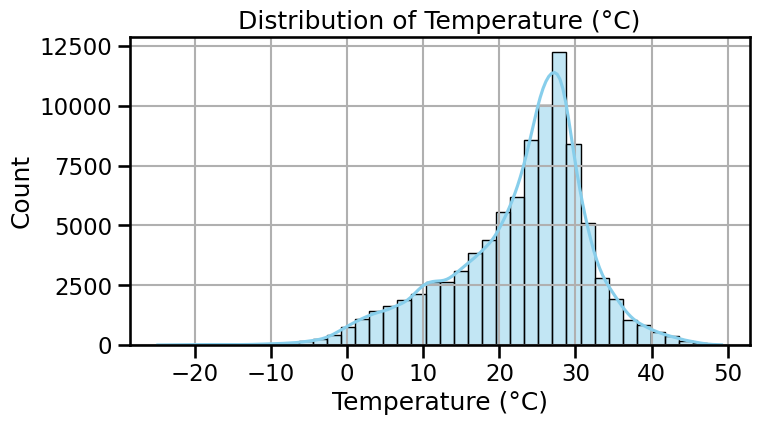

In [54]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convert datetime column
df["last_updated"] = pd.to_datetime(df["last_updated"], errors="coerce")

# Select important numeric columns
numeric_cols = [
    "temperature_celsius", "humidity", "wind_kph", "pressure_mb",
    "precip_mm", "uv_index", "visibility_km", "gust_kph",
    "air_quality_pm2_5", "air_quality_pm10" # Corrected column names
]

# --- 1. Summary statistics ---
summary = df[numeric_cols].describe().T
print("📊 Summary Statistics:\n", summary)

# --- 2. Distribution plots ---
#Temperature Distribution
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,4))
sns.histplot(df["temperature_celsius"].dropna(), bins=40, kde=True, color="skyblue")
plt.title("Distribution of Temperature (°C)")
plt.xlabel("Temperature (°C)")
plt.show()


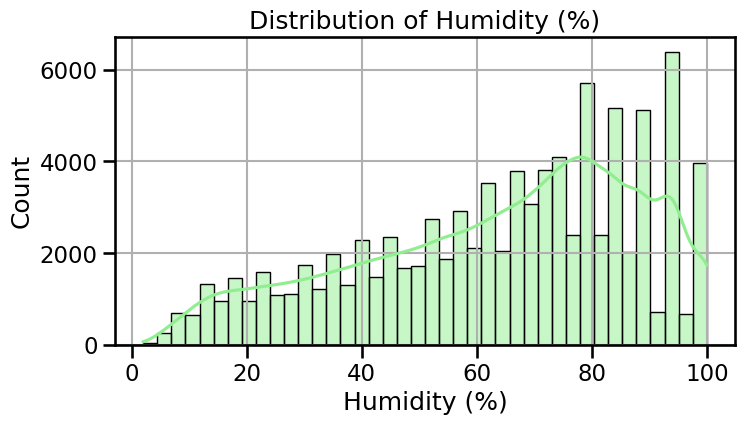

In [55]:
#Distribution of Humidity
plt.figure(figsize=(8,4))
sns.histplot(df["humidity"].dropna(), bins=40, kde=True, color="lightgreen")
plt.title("Distribution of Humidity (%)")
plt.xlabel("Humidity (%)")
plt.show()


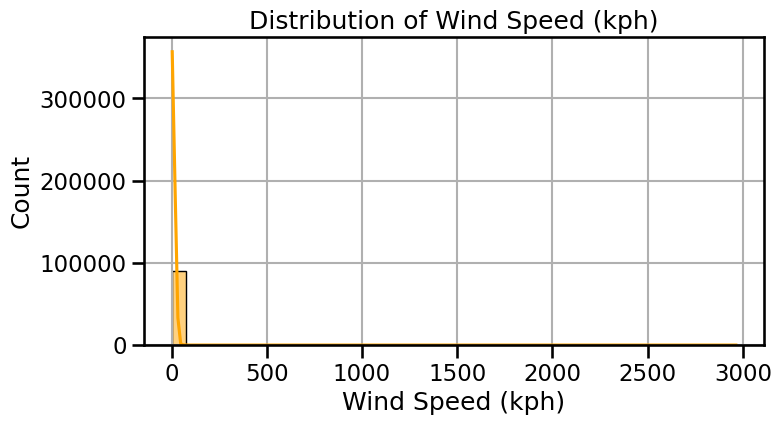

In [56]:
#Distribution of Wind speed
plt.figure(figsize=(8,4))
sns.histplot(df["wind_kph"].dropna(), bins=40, kde=True, color="orange")
plt.title("Distribution of Wind Speed (kph)")
plt.xlabel("Wind Speed (kph)")
plt.show()


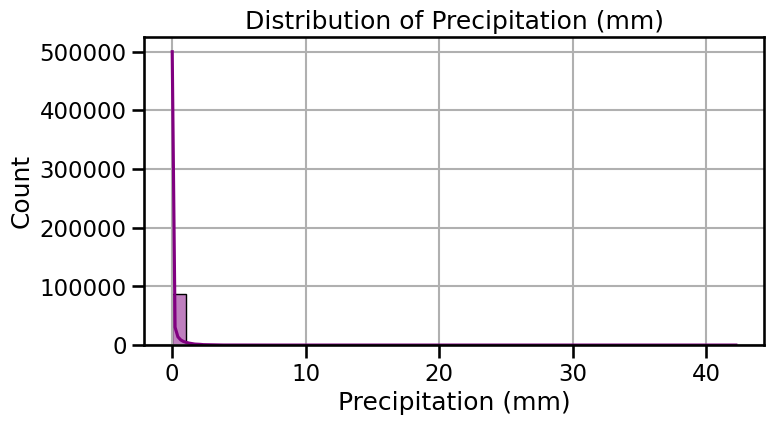

In [57]:
#Distribution of precipitation
plt.figure(figsize=(8,4))
sns.histplot(df["precip_mm"].dropna(), bins=40, kde=True, color="purple")
plt.title("Distribution of Precipitation (mm)")
plt.xlabel("Precipitation (mm)")
plt.show()


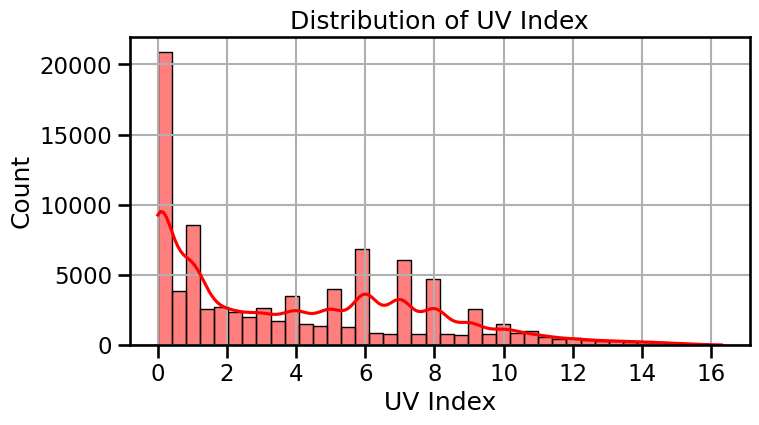

In [58]:
#Distribution of UV index
plt.figure(figsize=(8,4))
sns.histplot(df["uv_index"].dropna(), bins=40, kde=True, color="red")
plt.title("Distribution of UV Index")
plt.xlabel("UV Index")
plt.show()


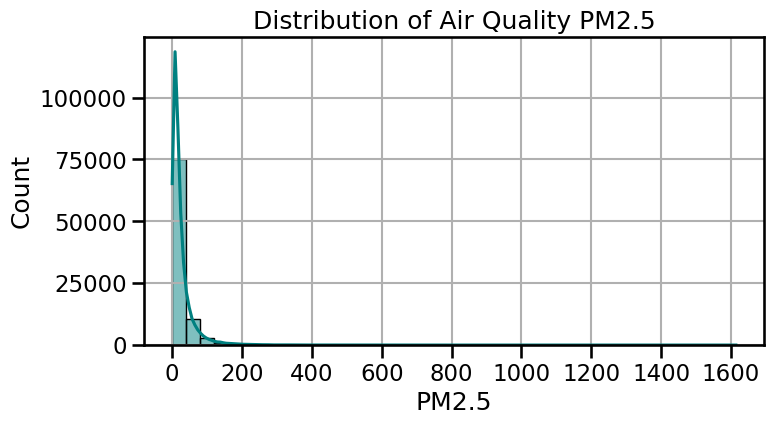

In [60]:
#Distribution of air quality
plt.figure(figsize=(8,4))
sns.histplot(df["air_quality_pm2_5"].dropna(), bins=40, kde=True, color="teal") # Corrected column name
plt.title("Distribution of Air Quality PM2.5")
plt.xlabel("PM2.5")
plt.show()

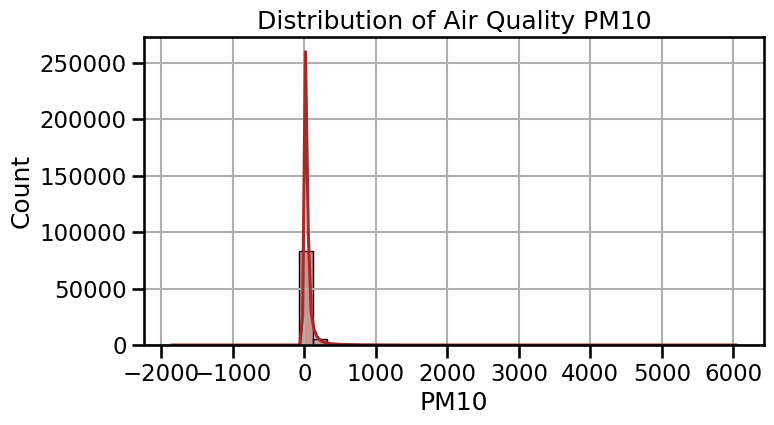

In [62]:
#Distribution of air Quality
plt.figure(figsize=(8,4))
sns.histplot(df["air_quality_pm10"].dropna(), bins=40, kde=True, color="brown") # Corrected column name
plt.title("Distribution of Air Quality PM10")
plt.xlabel("PM10")
plt.show()

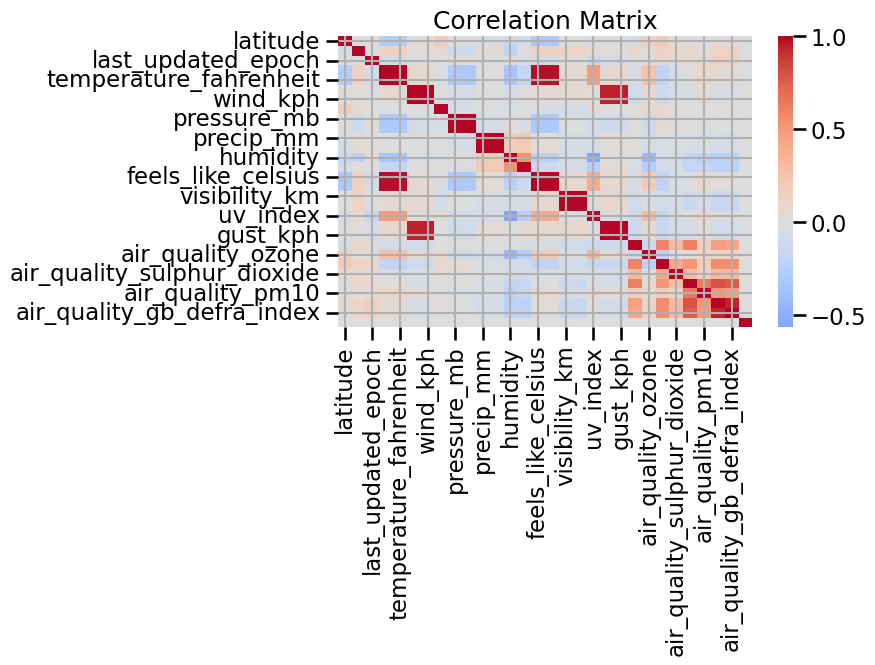

In [77]:
# 3) Correlations
# Calculate correlation matrix and find top correlated pairs
numdf = df.select_dtypes(include=[np.number]).copy()
corr = numdf.corr(numeric_only=True)

# Pairwise scatter for top correlated pairs (advanced)
top_pairs = (corr.unstack().dropna().sort_values(key=np.abs, ascending=False)
             .drop_duplicates().reset_index())
top_pairs.columns = ["x","y","corr"]
top_pairs = top_pairs[top_pairs["x"]!=top_pairs["y"]][:6]


# Plot Correlation Matrix
plt.figure(figsize=(9,7))
sns.heatmap(corr, cmap="coolwarm", center=0)
plt.title("Correlation Matrix")
plt.tight_layout()
plt.show()


In [ ]:
#  4) Aggregations
if "country" in df.columns and "date" in df.columns:
# (A) Daily Aggregation
  daily_agg = df.groupby(["country", "date"]).agg({
  "temperature_celsius": "mean",
  "humidity": "mean",
  "wind_kph": "mean",
  "precip_mm": "sum"
  }).reset_index()


  print("\n--- Daily Aggregation Example ---")
  print(daily_agg.head())


--- Daily Aggregation Example ---
       country        date  temperature_celsius  humidity  wind_kph  precip_mm
0  Afghanistan  2024-05-16                 24.3      32.5     10.25       0.03
1  Afghanistan  2024-05-17                 15.0      75.0      5.40       0.69
2  Afghanistan  2024-05-18                 19.5      46.0      3.60       0.00
3  Afghanistan  2024-05-19                 16.9      52.0      6.50       0.17
4  Afghanistan  2024-05-20                 14.1      77.0      4.30       0.72


In [ ]:
# (B) Monthly Aggregation
monthly_agg = df.groupby(["country", "year", "month"]).agg({
"temperature_celsius": "mean",
"humidity": "mean",
"wind_kph": "mean",
"precip_mm": "sum"
}).reset_index()


print("\n--- Monthly Aggregation Example ---")
print(monthly_agg.head())


--- Monthly Aggregation Example ---
       country  year  month  temperature_celsius   humidity   wind_kph  \
0  Afghanistan  2024      5            20.305882  38.058824  11.517647   
1  Afghanistan  2024      6            25.590000  24.833333  17.110000   
2  Afghanistan  2024      7            31.303448  17.931034  20.731034   
3  Afghanistan  2024      8            30.848387  20.548387  20.196774   
4  Afghanistan  2024      9            28.216667  13.733333  12.223333   

   precip_mm  
0       1.85  
1       2.18  
2       0.01  
3       1.15  
4       0.43  


/tmp/ipython-input-2827161163.py:45: UserWarning: Glyph 127757 (\N{EARTH GLOBE EUROPE-AFRICA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127757 (\N{EARTH GLOBE EUROPE-AFRICA}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


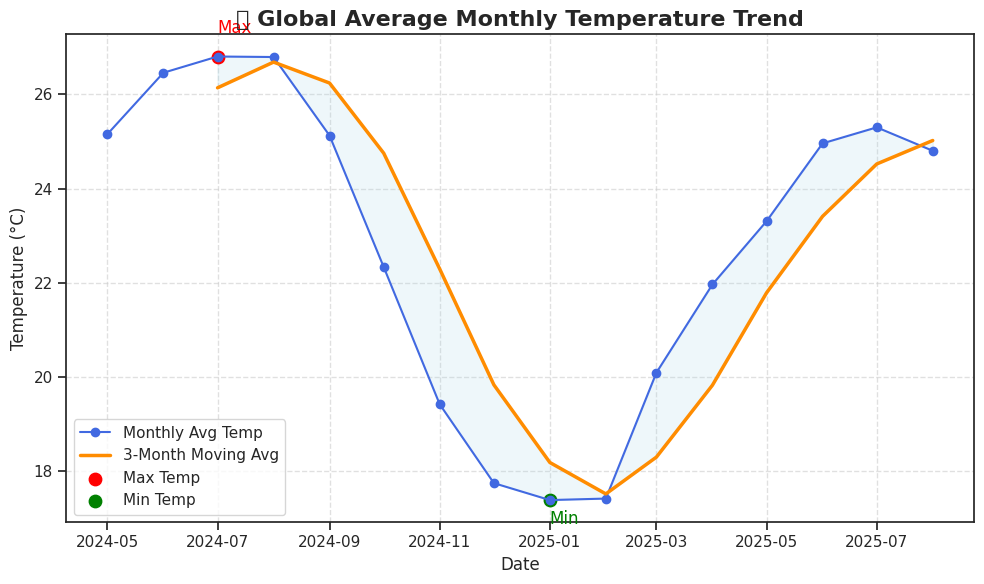

In [ ]:
# Global Monthly Average
import pandas as pd
import matplotlib.pyplot as plt

# Group data
global_monthly = df.groupby(["year", "month"]).agg({
    "temperature_celsius": "mean",
    "humidity": "mean",
    "wind_kph": "mean",
    "precip_mm": "sum"
}).reset_index()

# Create timeline
timeline = pd.to_datetime(global_monthly[["year", "month"]].assign(day=1))

# Moving average (3-month rolling window for smoothing)
global_monthly["temp_smooth"] = global_monthly["temperature_celsius"].rolling(window=3).mean()

# Plot
plt.figure(figsize=(10,6))
plt.plot(timeline, global_monthly["temperature_celsius"], marker="o", linestyle="-", color="royalblue", label="Monthly Avg Temp")
plt.plot(timeline, global_monthly["temp_smooth"], color="darkorange", linewidth=2.5, label="3-Month Moving Avg")

# Fill between (highlight seasonal area)
plt.fill_between(timeline, global_monthly["temperature_celsius"], global_monthly["temp_smooth"],
                 color="lightblue", alpha=0.2)

# Highlight max & min points
max_idx = global_monthly["temperature_celsius"].idxmax()
min_idx = global_monthly["temperature_celsius"].idxmin()
plt.scatter(timeline[max_idx], global_monthly["temperature_celsius"][max_idx], color="red", s=80, label="Max Temp")
plt.scatter(timeline[min_idx], global_monthly["temperature_celsius"][min_idx], color="green", s=80, label="Min Temp")

# Annotate
plt.text(timeline[max_idx], global_monthly["temperature_celsius"][max_idx]+0.5, "Max", color="red")
plt.text(timeline[min_idx], global_monthly["temperature_celsius"][min_idx]-0.5, "Min", color="green")

# Titles and labels
plt.title("🌍 Global Average Monthly Temperature Trend", fontsize=16, weight="bold")
plt.xlabel("Date", fontsize=12)
plt.ylabel("Temperature (°C)", fontsize=12)

# Grid and style
plt.grid(True, linestyle="--", alpha=0.6)
plt.legend()
plt.tight_layout()
plt.show()


/tmp/ipython-input-114067364.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


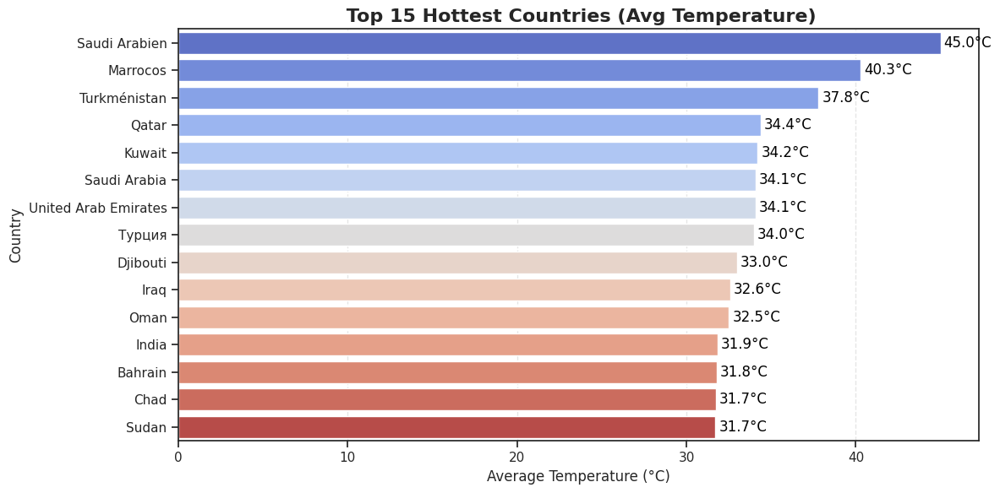

In [ ]:
# (C) Regional Aggregation - Avg Temp
avg_temp_country = (
    df.groupby("country")["temperature_celsius"]
    .mean()
    .sort_values(ascending=False)
    .head(15)
)

plt.figure(figsize=(12,6))
sns.barplot(
    x=avg_temp_country.values,
    y=avg_temp_country.index,
    palette="coolwarm"
)

# Add annotations
for i, v in enumerate(avg_temp_country.values):
    plt.text(v + 0.2, i, f"{v:.1f}°C", color="black", va="center")

plt.title(" Top 15 Hottest Countries (Avg Temperature)", fontsize=16, weight="bold")
plt.xlabel("Average Temperature (°C)")
plt.ylabel("Country")
plt.grid(axis="x", linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


/tmp/ipython-input-2955656167.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


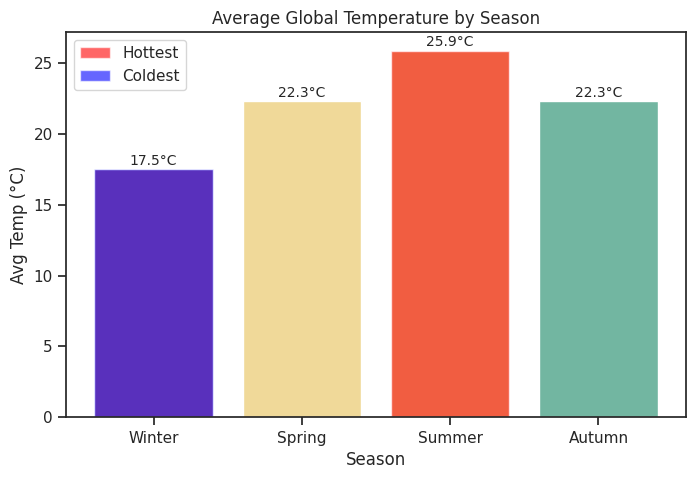

In [ ]:
# (D). Seasonal Aggregation
# Ensure 'season' column exists
def map_season(month):
    if month in [12, 1, 2]:
        return "Winter"
    elif month in [3, 4, 5]:
        return "Spring"
    elif month in [6, 7, 8]:
        return "Summer"
    else:
        return "Autumn"

if "month" in df.columns:
    df["season"] = df["month"].apply(map_season)
else:
    print(" 'month' column missing - make sure last_updated → month was created!")

# Order seasons properly
season_order = ["Winter", "Spring", "Summer", "Autumn"]
seasonal_agg = (
    df.groupby("season")["temperature_celsius"]
    .mean()
    .reindex(season_order)
    .reset_index()
)

plt.figure(figsize=(8,5))
sns.barplot(
    x="season",
    y="temperature_celsius",
    data=seasonal_agg,
    palette="Spectral",
    order=season_order
)

# Add annotations
for i, v in enumerate(seasonal_agg["temperature_celsius"]):
    plt.text(i, v + 0.3, f"{v:.1f}°C", ha="center", fontsize=10)

# Highlight hottest & coldest season
max_idx = seasonal_agg["temperature_celsius"].idxmax()
min_idx = seasonal_agg["temperature_celsius"].idxmin()

plt.bar(
    seasonal_agg.loc[max_idx, "season"],
    seasonal_agg.loc[max_idx, "temperature_celsius"],
    color="red", alpha=0.6, label="Hottest"
)
plt.bar(
    seasonal_agg.loc[min_idx, "season"],
    seasonal_agg.loc[min_idx, "temperature_celsius"],
    color="blue", alpha=0.6, label="Coldest"
)

plt.legend()
plt.title("Average Global Temperature by Season")
plt.ylabel("Avg Temp (°C)")
plt.xlabel("Season")
plt.show()


🌍 Average Weather Conditions in India:
temperature_celsius    31.854095
humidity               42.812500
wind_kph               10.472198
precip_mm               0.073405
dtype: float64


/tmp/ipython-input-1985628257.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=india_avg.index, y=india_avg.values, palette="viridis")
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127757 (\N{EARTH GLOBE EUROPE-AFRICA}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


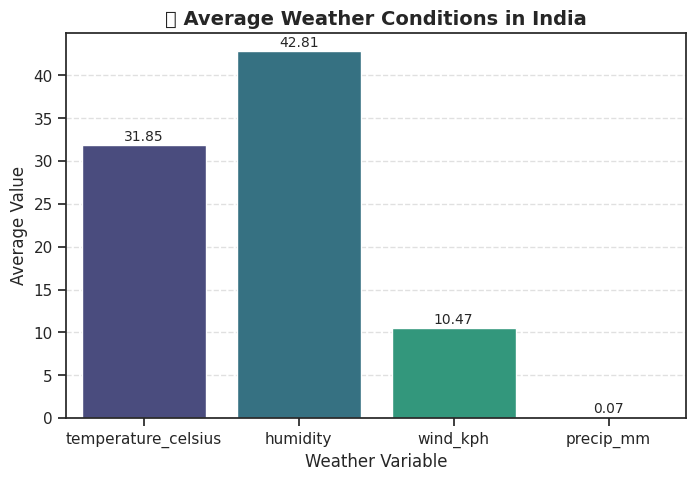

In [ ]:
# Filter India data
india_df = df[df['country'] == "India"]

# Compute averages (mean for climate variables)
india_avg = india_df[["temperature_celsius", "humidity", "wind_kph", "precip_mm"]].mean()

print("🌍 Average Weather Conditions in India:")
print(india_avg)

# Plot India’s average weather conditions
plt.figure(figsize=(8,5))
sns.barplot(x=india_avg.index, y=india_avg.values, palette="viridis")

# Add annotations on bars
for i, v in enumerate(india_avg.values):
    plt.text(i, v + 0.5, f"{v:.2f}", ha="center", fontsize=10)

plt.title("🌍 Average Weather Conditions in India", fontsize=14, weight="bold")
plt.ylabel("Average Value")
plt.xlabel("Weather Variable")
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.show()
